In [2]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [3]:
df = pd.read_csv("NFLX.csv")

In [4]:
df.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,2018-02-05,262.000000,267.899994,250.029999,254.259995,254.259995,11896100
1,2018-02-06,247.699997,266.700012,245.000000,265.720001,265.720001,12595800
2,2018-02-07,266.579987,272.450012,264.329987,264.559998,264.559998,8981500
3,2018-02-08,267.079987,267.619995,250.000000,250.100006,250.100006,9306700
4,2018-02-09,253.850006,255.800003,236.110001,249.470001,249.470001,16906900


In [5]:
df.isnull().sum()

Date         0
Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [6]:
df = df.drop(['Date'],axis=1)

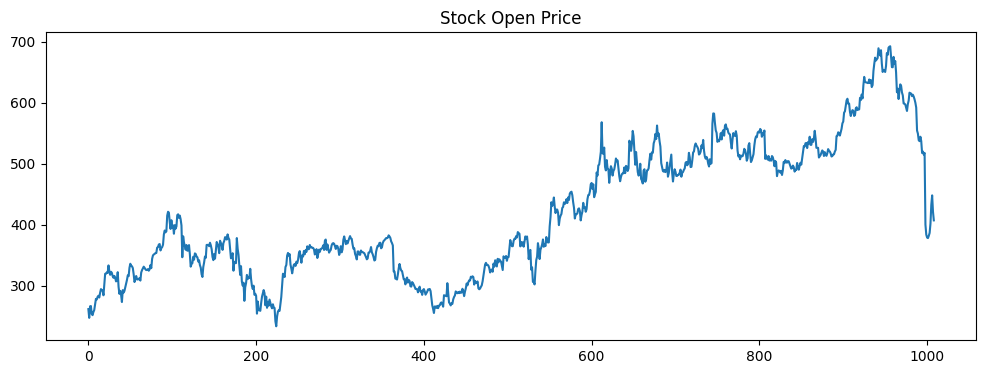

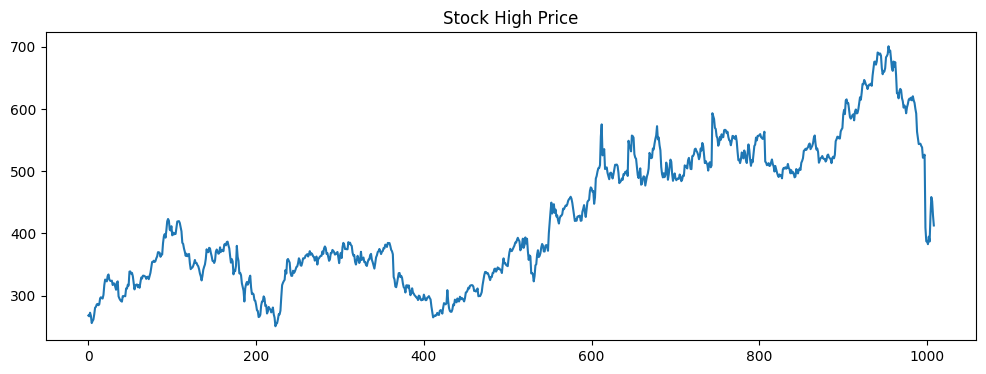

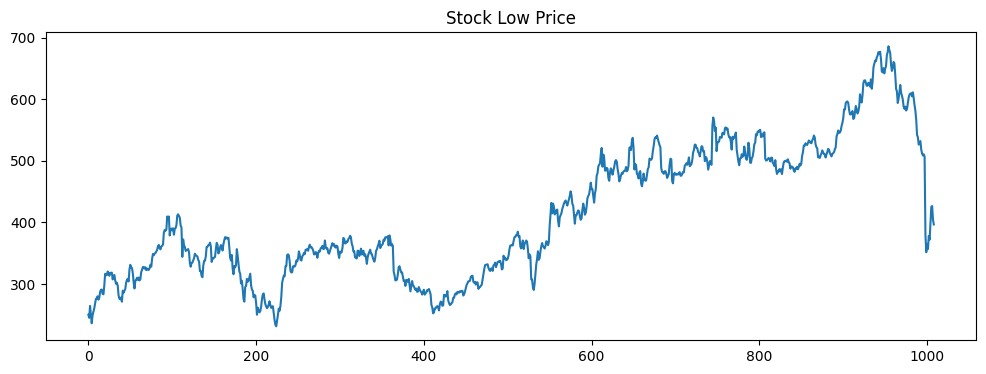

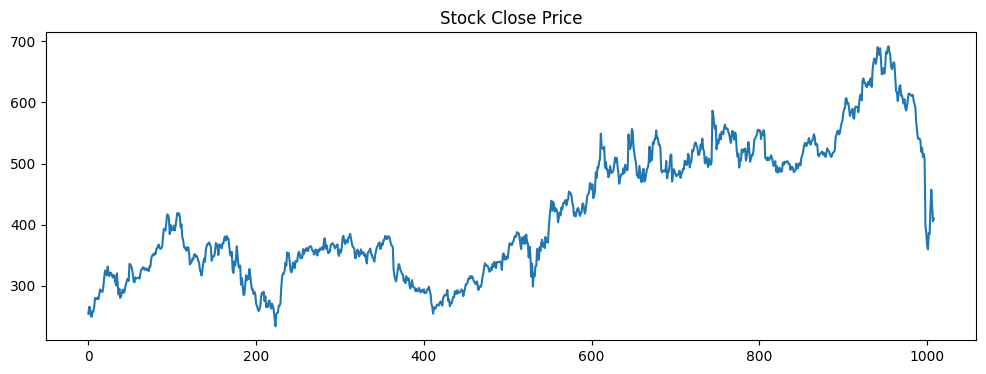

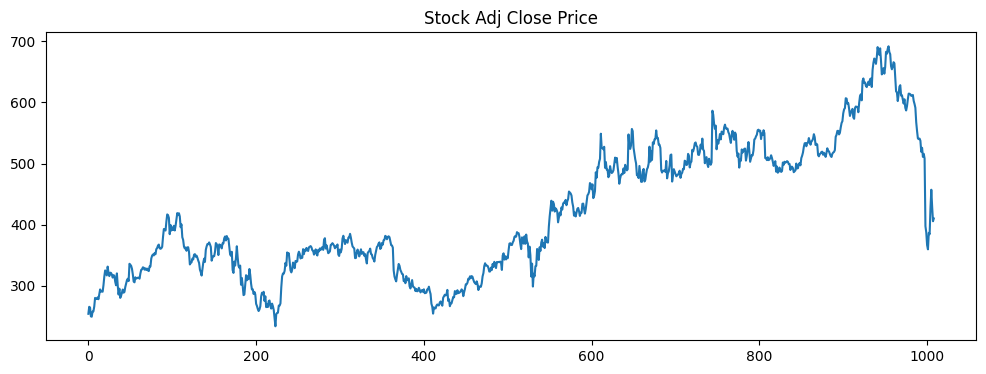

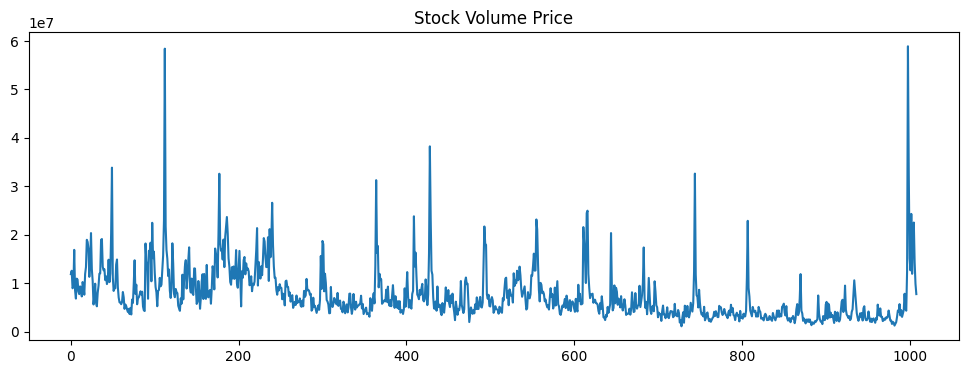

In [7]:
for columns in df.columns:
    plt.figure(figsize=(12,4))
    plt.title(f"Stock {columns} Price")
    plt.plot(df.index,df[columns])
    plt.show()


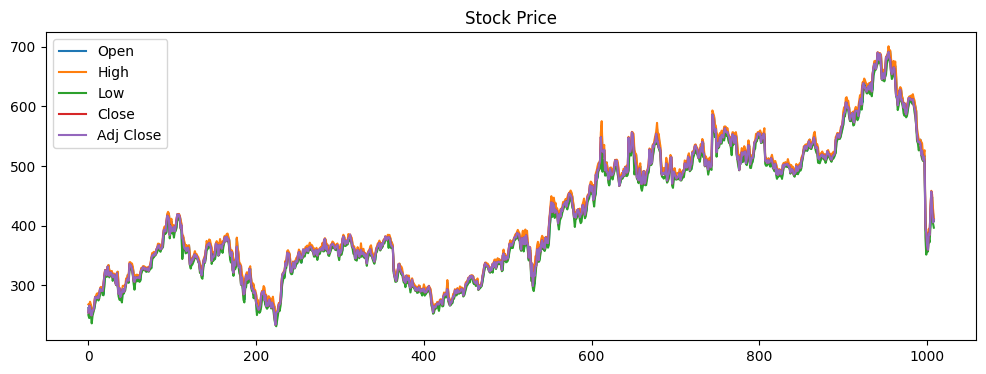

In [8]:
plt.figure(figsize=(12,4))
plt.title("Stock Price")
for columns in df.columns:
    if(columns !='Volume'):
        plt.plot(df.index,df[columns],label=columns)
plt.legend()

In [9]:
data = df['Close']
print(data)

0       254.259995
1       265.720001
2       264.559998
3       250.100006
4       249.470001
           ...    
1004    427.140015
1005    457.130005
1006    429.480011
1007    405.600006
1008    410.170013
Name: Close, Length: 1009, dtype: float64


In [10]:
scaler=MinMaxScaler()
data = np.array(data)
data = data.reshape(-1,1)
dfx = scaler.fit_transform(data)

In [11]:
dfx

array([[0.04451626],
       [0.06954849],
       [0.06701469],
       ...,
       [0.4272515 ],
       [0.37509011],
       [0.38507243]])

In [12]:
X = []
y = []
for i in range(0,len(dfx)-1):
    X.append(dfx[0:i+1])
    y.append(dfx[i+1])

In [13]:
len(X[1007])

1008

In [14]:
X

[array([[0.04451626]]),
 array([[0.04451626],
        [0.06954849]]),
 array([[0.04451626],
        [0.06954849],
        [0.06701469]]),
 array([[0.04451626],
        [0.06954849],
        [0.06701469],
        [0.03542955]]),
 array([[0.04451626],
        [0.06954849],
        [0.06701469],
        [0.03542955],
        [0.03405342]]),
 array([[0.04451626],
        [0.06954849],
        [0.06701469],
        [0.03542955],
        [0.03405342],
        [0.05257641]]),
 array([[0.04451626],
        [0.06954849],
        [0.06701469],
        [0.03542955],
        [0.03405342],
        [0.05257641],
        [0.05327534]]),
 array([[0.04451626],
        [0.06954849],
        [0.06701469],
        [0.03542955],
        [0.03405342],
        [0.05257641],
        [0.05327534],
        [0.0701601 ]]),
 array([[0.04451626],
        [0.06954849],
        [0.06701469],
        [0.03542955],
        [0.03405342],
        [0.05257641],
        [0.05327534],
        [0.0701601 ],
        [0.10133

In [15]:
X_new = []
for i in range(len(X)):
    temp = []
    for j in range(len(X[i])):
        for k in range(len(X[i][j])):
            temp.append(X[i][j][k])
    # temp = np.array(temp)
    X_new.append(temp)


In [16]:
X_new

[[0.044516262496556935],
 [0.044516262496556935, 0.06954849437243715],
 [0.044516262496556935, 0.06954849437243715, 0.06701468557052936],
 [0.044516262496556935,
  0.06954849437243715,
  0.06701468557052936,
  0.0354295474242341],
 [0.044516262496556935,
  0.06954849437243715,
  0.06701468557052936,
  0.0354295474242341,
  0.03405341976400733],
 [0.044516262496556935,
  0.06954849437243715,
  0.06701468557052936,
  0.0354295474242341,
  0.03405341976400733,
  0.05257641195633389],
 [0.044516262496556935,
  0.06954849437243715,
  0.06701468557052936,
  0.0354295474242341,
  0.03405341976400733,
  0.05257641195633389,
  0.05327534164790193],
 [0.044516262496556935,
  0.06954849437243715,
  0.06701468557052936,
  0.0354295474242341,
  0.03405341976400733,
  0.05257641195633389,
  0.05327534164790193,
  0.07016009962753167],
 [0.044516262496556935,
  0.06954849437243715,
  0.06701468557052936,
  0.0354295474242341,
  0.03405341976400733,
  0.05257641195633389,
  0.05327534164790193,
  0.07

In [17]:
max_len = max([len(x) for x in X_new])

In [18]:
max_len

1008

In [19]:
X_new_padded = tf.keras.utils.pad_sequences(X_new, maxlen = max_len, dtype='float64', padding='pre')

In [20]:
y_new_padded = tf.keras.utils.pad_sequences(y, maxlen = max_len, dtype='float64', padding='pre')

In [21]:
y_new_padded

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.06954849],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.06701469],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.03542955],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.4272515 ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.37509011],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.38507243]])

In [22]:
X_new_padded

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.04451626],
       [0.        , 0.        , 0.        , ..., 0.        , 0.04451626,
        0.06954849],
       [0.        , 0.        , 0.        , ..., 0.04451626, 0.06954849,
        0.06701469],
       ...,
       [0.        , 0.        , 0.04451626, ..., 0.32869527, 0.42214021,
        0.48764772],
       [0.        , 0.04451626, 0.06954849, ..., 0.42214021, 0.48764772,
        0.4272515 ],
       [0.04451626, 0.06954849, 0.06701469, ..., 0.48764772, 0.4272515 ,
        0.37509011]])

In [23]:
X_new_padded = X_new_padded.reshape(-1, max_len, 1)
y = np.array(y)
y_new_padded = y_new_padded.reshape(-1, 1)
print(X_new_padded.shape)

(1008, 1008, 1)


In [24]:

y.shape

(1008, 1)

In [25]:
model = Sequential()
model.add(LSTM(64,return_sequences=True,input_shape=(X_new_padded[0].shape)))
model.add(LSTM(32))
model.add(Dense(16,activation='relu'))
model.add(Dense(1))

c:\Users\eshwa\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\layers\rnn\rnn.py:205: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [26]:
model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mae'])

In [27]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 1008, 64)       │        16,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 29,857 (116.63 KB)

 Trainable params: 29,857 (116.63 KB)

 Non-trainable params: 0 (0.00 B)

In [28]:
model.fit(X_new_padded,y,epochs=50)

Epoch 1/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 16s 394ms/step - loss: 0.0792 - mae: 0.2045
Epoch 2/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 379ms/step - loss: 0.0038 - mae: 0.0466
Epoch 3/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 377ms/step - loss: 0.0027 - mae: 0.0378
Epoch 4/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 13s 408ms/step - loss: 0.0023 - mae: 0.0357
Epoch 5/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 380ms/step - loss: 0.0023 - mae: 0.0341
Epoch 6/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 378ms/step - loss: 0.0020 - mae: 0.0324
Epoch 7/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 13s 404ms/step - loss: 0.0019 - mae: 0.0313
Epoch 8/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 375ms/step - loss: 0.0023 - mae: 0.0340
Epoch 9/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 386ms/step - loss: 0.0021 - mae: 0.0321
Epoch 10/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 383ms/step - loss: 0.0024 - mae: 0.0348
Epoch 11/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 380ms/step - loss: 0.0017 - mae: 0.0306
Epoch 12/50
32/32 ━━━━━━━━━━━━━━━━━━━━ 12s 375ms/step - loss: 0.0017 - mae: 0.0303
Epoch 13/50
3

In [29]:
model.save("trained_model.h5")

In [30]:
np.save("my_array.npy", X_new_padded)

In [15]:
import joblib
joblib.dump(scaler, 'scaler.pkl')

['scaler.pkl']

In [17]:
np.save("data.npy", data)